In [1]:
""" Lunatic Stocks
The Moon takes ~ 29.5 days to full orbit going around the Earth
Moon phases are irregular in time, as they can last 7 or 8 days in different times of the year and appear in different
days of the month. A Full Moon in Jan can be on the 2nd and in Nov on the 6th
Interesting patterns appear if sampling the Stock Markets with the irregular Moon phases 

                                                                             Luis A. Mateos"""
import datetime
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

# START_TEAR < Years to analyze < END_YEAR
START_YEAR = 2000#1990
END_YEAR = 2099

# Create object and computed data for plotting
class Lunatic:
    def __init__(self, num_of_vars, var, show):
        """Create objects. num_of_vars is the number of variables. var is the variables to analyze. show is verbosity 
        if var = day (day of the month)
        then num_of_vars = 32 (0 is not used, the days of the month start from 1)"""
        self.NUM_OF_VARS = num_of_vars #40 # 
        self.var = var
        self.show = show

        self.diff_array = [] # Store the diff per num_of_vars
        self.diff_sum_array = [] # Store the cumulative diff per num_of_vars
        self.diff_dateX_array = [] # Store the date per num_of_vars

        self.r_array = []  # result array
        self.r_array_sum = []  #result array cumulative

        with open("DJI_AM_lunardata.txt", "r") as f: 
            fd = [] # save all the file information as an array
            for x in f:
                fd.append(x)
            del fd[0] #remove header fron lhis file year,month,day,luna

        # Initialize arrays with num_of_vars arrays
        for x in range(self.NUM_OF_VARS):
            self.diff_array.append([])
            self.diff_sum_array.append([])
            self.diff_dateX_array.append([])
    
        """Loop all the records in the DB
        Depending on the var to analyze or NUM_OF_VARS fill the slots"""
        counter = 0
        self.diff_temp_array = []

        # Initialize the array from number of slots to zero
        for x in range(self.NUM_OF_VARS):
            self.diff_temp_array.append(0)

        # Loop through all the record in the DB
        for i in range(len(fd)):
            td = fd[i]
            td = td.split(",")
            yyyy_mm_dd = td[1]+"-"+td[2]+"-"+td[3]
            xyear = int(td[1])    #1
            xmonth = int(td[2])   #2
            xday = int(td[3])     #3
            xweek = int(td[4])    #4
            xweekday = int(td[5]) #5
            xday365 = int(td[6])  #6

            xdiff = float(td[16]) #7
            xluna = int(td[27])   #8
            if self.var == "luna":
                xvar = xluna
            elif self.var == "year":
                xvar = xyear
            elif self.var == "month":
                xvar = xmonth
            elif self.var == "day":
                xvar = xday
            elif self.var == "week":
                xvar = xweek
            elif self.var == "weekday":
                xvar = xweekday
            elif self.var == "day365":
                xvar = xday365
            else:
                xvar = xluna

            # Start from start_year variable
            #-------------------------------
            if xyear >= START_YEAR: 
                if xyear >= START_YEAR: # conditional with other variables xweek == 53:#xmonth == 12: 
                    counter += 1
                    self.diff_temp_array[xvar] += xdiff
                    self.diff_sum_array[xvar].append(self.diff_temp_array[xvar])
                    self.diff_array[xvar].append(xdiff)
                    self.diff_dateX_array[xvar].append(yyyy_mm_dd)
        if self.show == "yes":
            print("n=",str(counter))

        # Preprocess the DB and get
        i = 0
        r_temp = 0

        for a in self.diff_temp_array:
            if self.show == "yes":
                print(i, a)
            self.r_array.append(a)
            r_temp+=a
            self.r_array_sum.append(r_temp)
            i += 1


In [2]:
#===================================================
# Create objects with computed variables
#===================================================
NUM_OF_VARS = 40 #
var = "luna"
show = "no"
xluna = Lunatic(NUM_OF_VARS, var, show)
print("luna")

NUM_OF_VARS = 32 #
var = "day"
show = "no"
xday = Lunatic(NUM_OF_VARS, var, show)
print("day")

NUM_OF_VARS = 13 #
var = "month"
show = "no"
xmonth = Lunatic(NUM_OF_VARS, var, show)
print("month")

NUM_OF_VARS = 54 #
var = "week"
show = "no"
xweek = Lunatic(NUM_OF_VARS, var, show)
print("week")

NUM_OF_VARS = 6 #
var = "weekday"
show = "no"
xweekday = Lunatic(NUM_OF_VARS, var, show)
print("weekday")

NUM_OF_VARS = 367 #
var = "day365"
show = "no"
xday365 = Lunatic(NUM_OF_VARS, var, show)
print("day365")

luna
day
month
week
weekday
day365


In [3]:
#===================================================
# Plot functions for the variables and its contituting periods
#===================================================

def plot_variable(x_var, x_label="", y_label="", legend1="",legend2=""):
    """Plot the variable in consideration with the proper x and y label and legend for the data"""
    plt.figure(figsize=(15, 5))
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.plot(x_var.r_array, label=legend1)
    plt.plot(x_var.r_array, 'o')
    plt.plot(x_var.r_array_sum, label=legend2)
    plt.legend(loc="upper left")

    plt.grid()
    plt.show()
    
def plot_periods(x_var, xperiod, x_label="", y_label="", legend1="",legend2=""):
    """Plot the sampling period of the variable in consideration"""
    plt.figure(figsize=(15, 5))
    plt.xlabel(x_label + str(xperiod))
    plt.ylabel(y_label)
    plt.plot(x_var.diff_array[xperiod], label=legend1 + str(xperiod))#(r_array)
    #plt.plot(r_array, 'o')
    plt.plot(x_var.diff_sum_array[xperiod], label=legend2)#(r_array_sum)
    plt.legend(loc="upper left")
    plt.grid()
    plt.show()

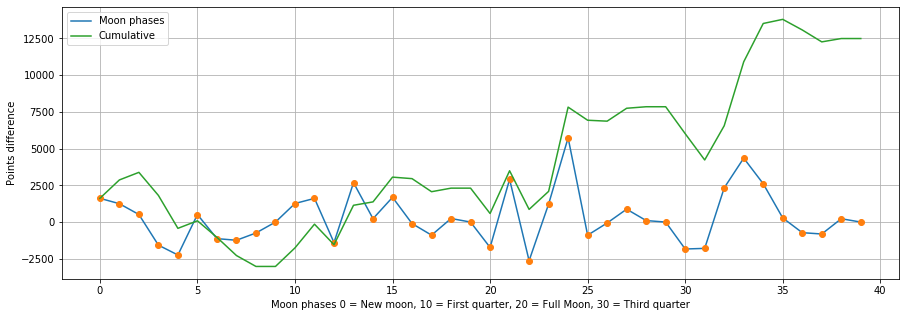

In [4]:
#===================================================
# Moon phases
NUM_OF_VARS = 40 
# var = "luna"
#===================================================

x_label="Moon phases 0 = New moon, 10 = First quarter, 20 = Full Moon, 30 = Third quarter"
y_label="Points difference"
legend1="Moon phases"
legend2="Cumulative"

plot_variable(xluna, x_label, y_label, legend1,legend2)

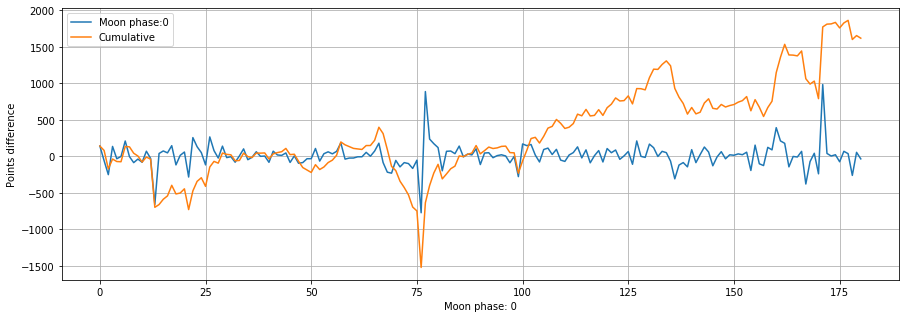

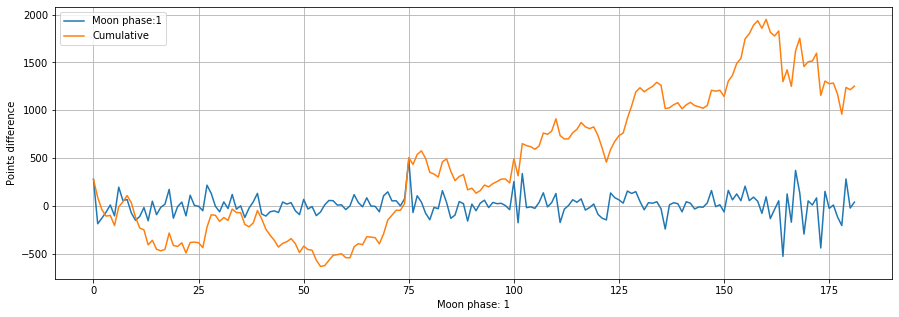

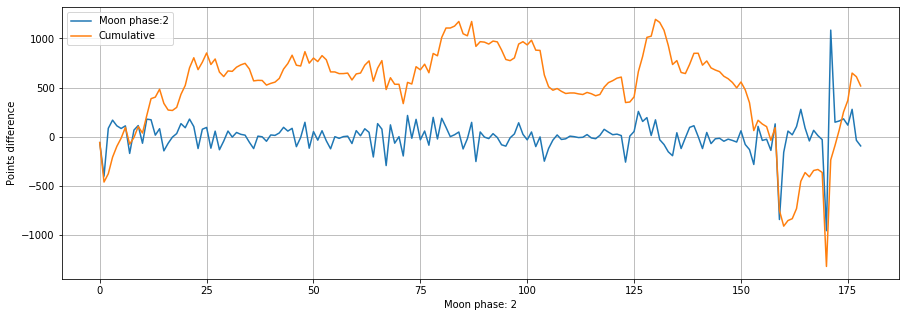

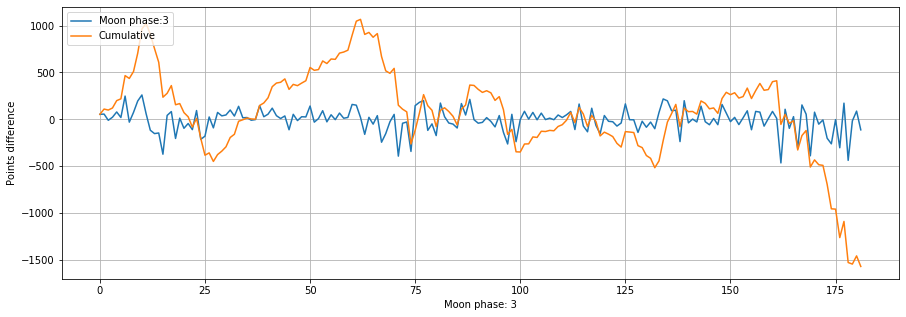

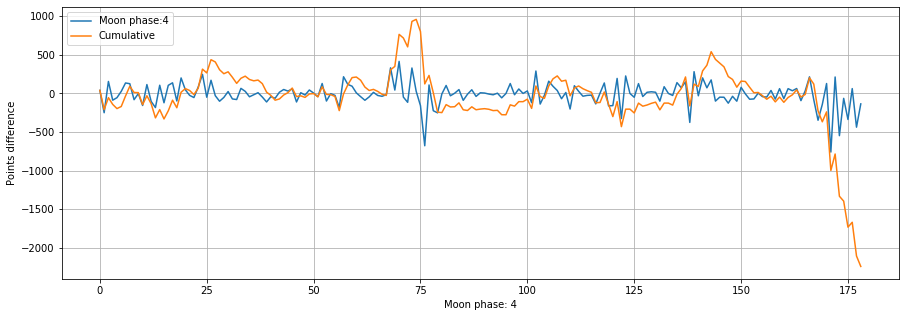

...

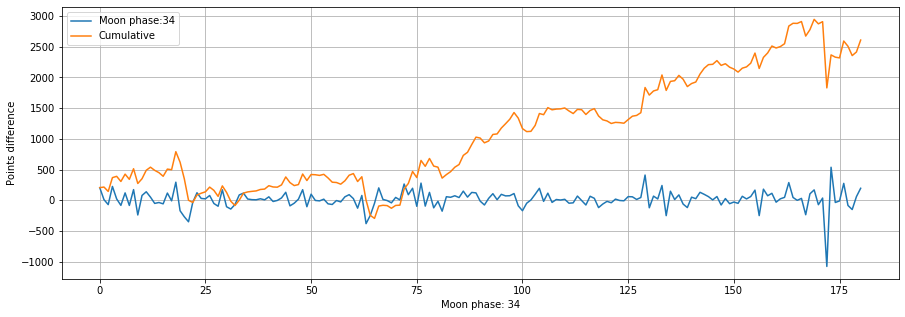

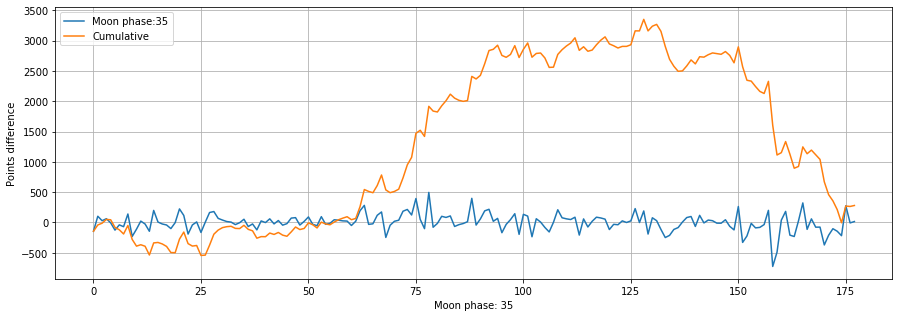

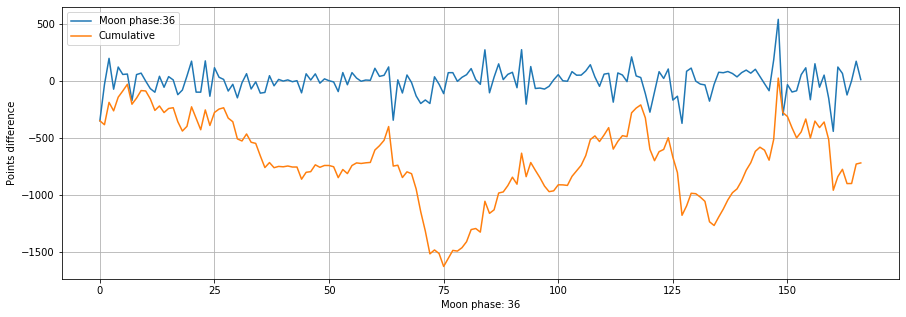

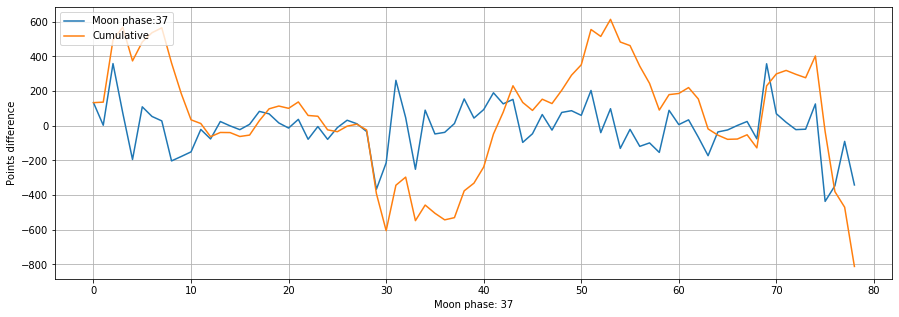

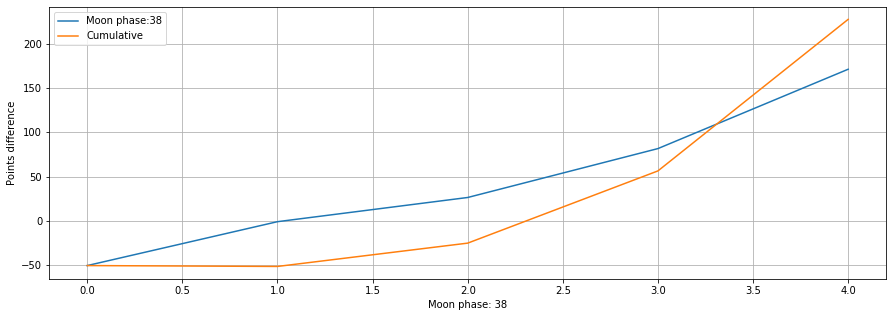

In [5]:
x_var = xluna
x_label = "Moon phase: "
y_label = "Points difference"
legend1 = "Moon phase:"
legend2 = "Cumulative"

for period in range(NUM_OF_VARS):
    if period == 9 or period == 19 or period == 29 or period >= 39: 
        # remove the periods out of range from the single array
        pass
    else:
        plot_periods(x_var, period, x_label, y_label, legend1,legend2)
        # New Moon 0 to 8
        # First quarter 10 to 18
        # Full Moon 20 to 28
        # Third quarter 30 to 38

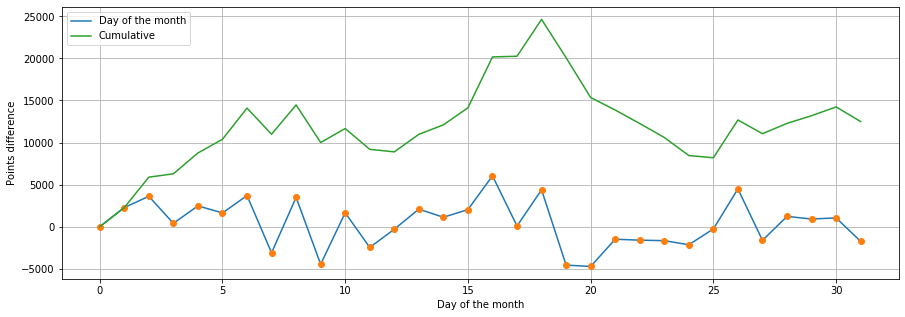

In [6]:
#===================================================
# Day of the month
NUM_OF_VARS = 32 
# var = "day"
#===================================================

x_label="Day of the month"
y_label="Points difference"
legend1="Day of the month"
legend2="Cumulative"

plot_variable(xday, x_label, y_label, legend1,legend2)

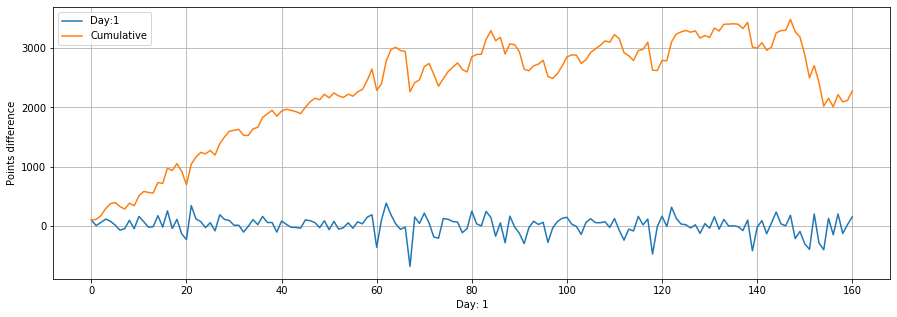

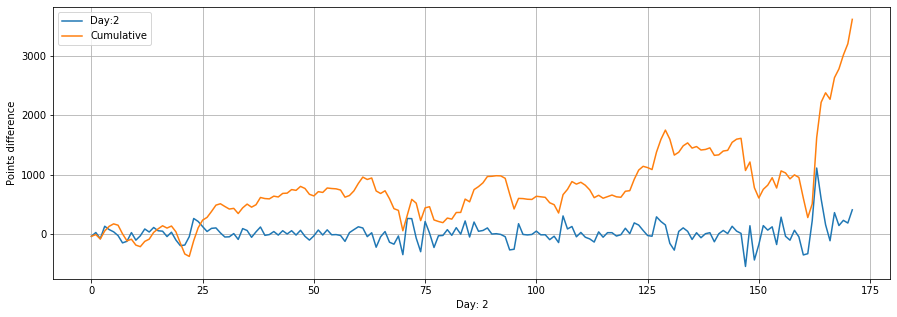

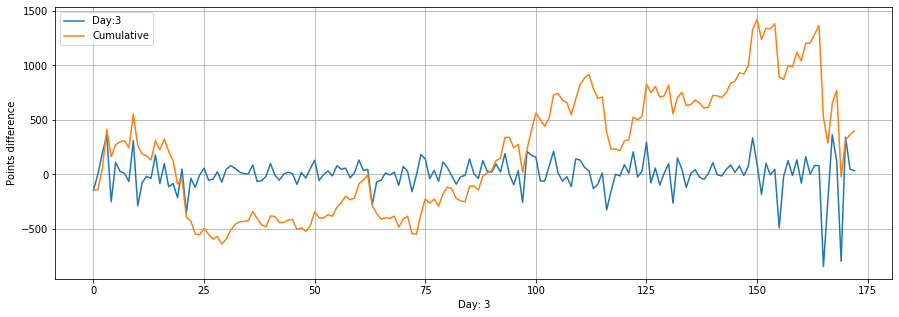

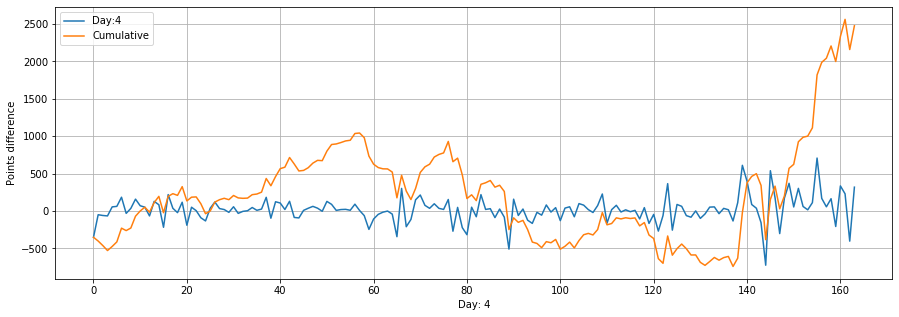

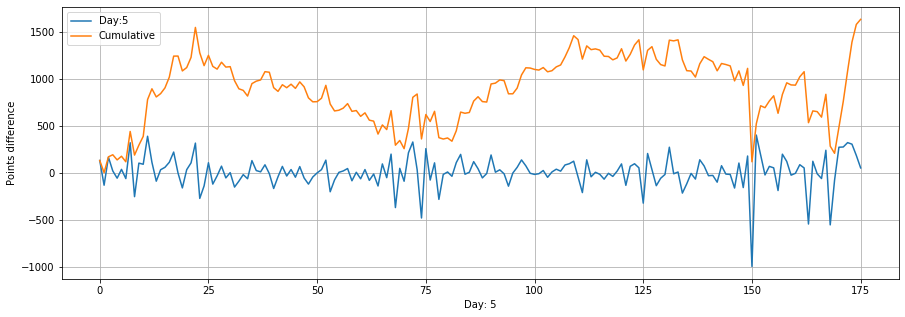

...

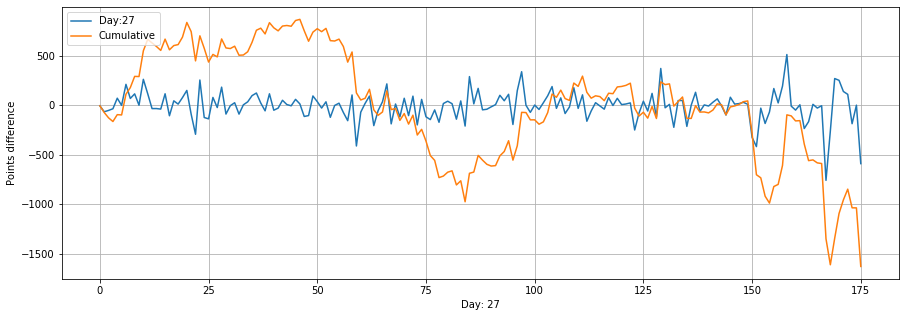

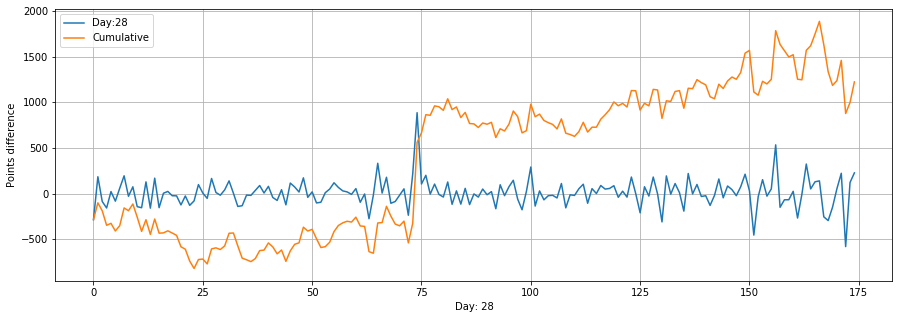

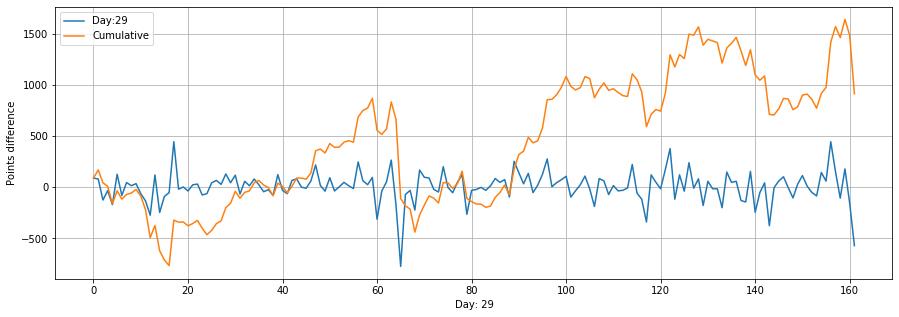

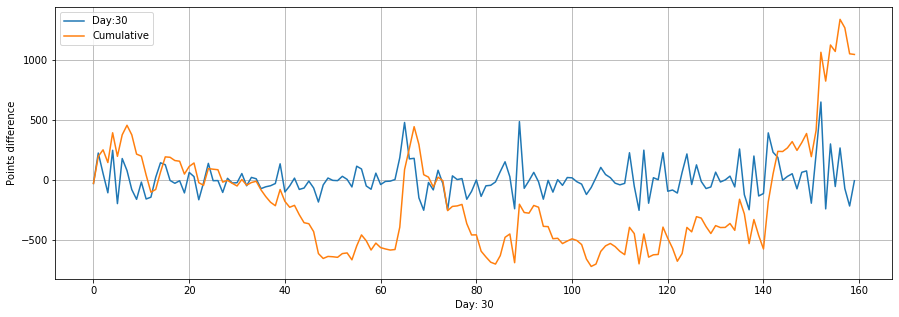

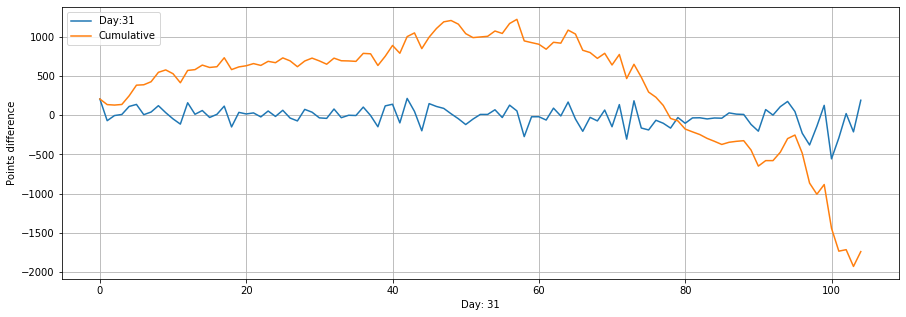

In [7]:
x_var = xday
x_label = "Day: "
y_label = "Points difference"
legend1 = "Day:"
legend2 = "Cumulative"

for period in range(NUM_OF_VARS):
    if period > 0:
        plot_periods(x_var, period, x_label, y_label, legend1,legend2)

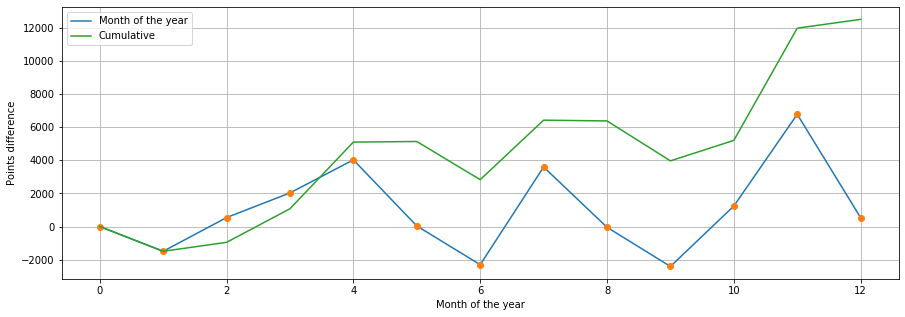

In [8]:
#===================================================
# Month of the year
NUM_OF_VARS = 13 
# var = "month"
#===================================================

x_label="Month of the year"
y_label="Points difference"
legend1="Month of the year"
legend2="Cumulative"

plot_variable(xmonth, x_label, y_label, legend1,legend2)

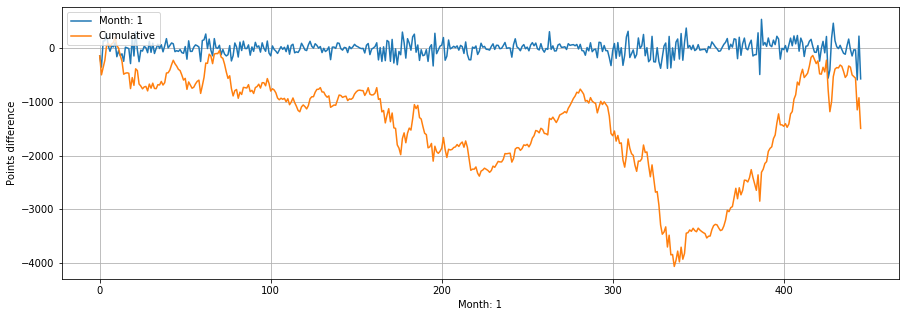

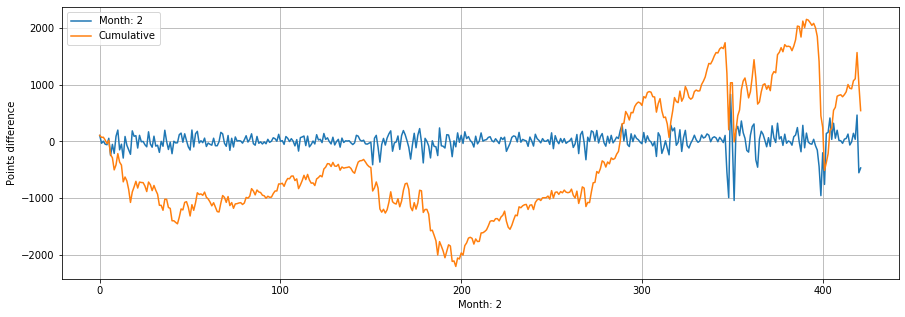

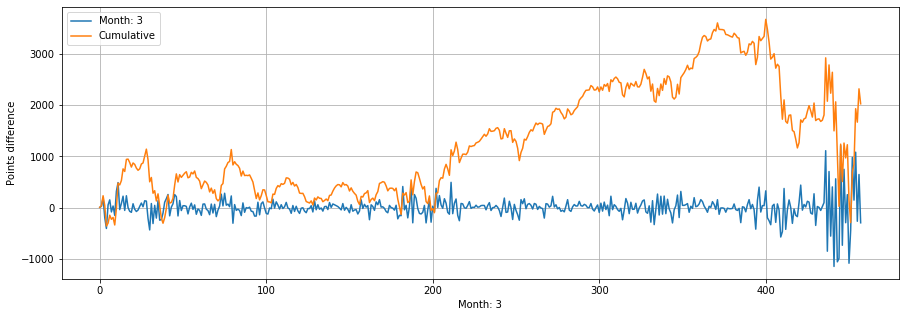

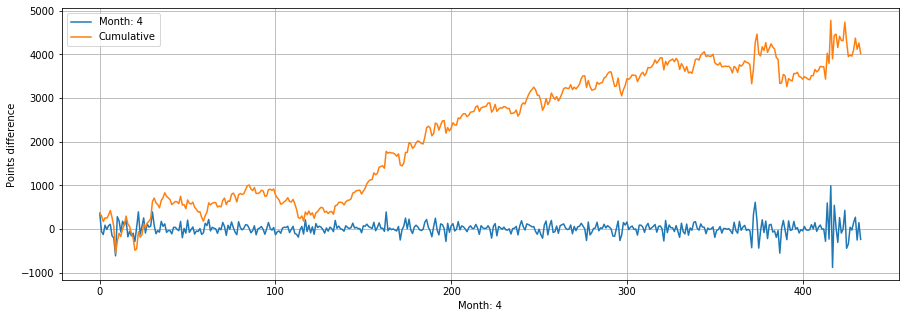

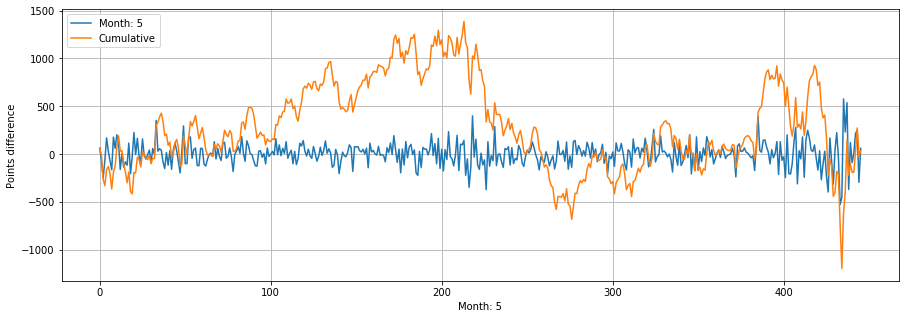

...

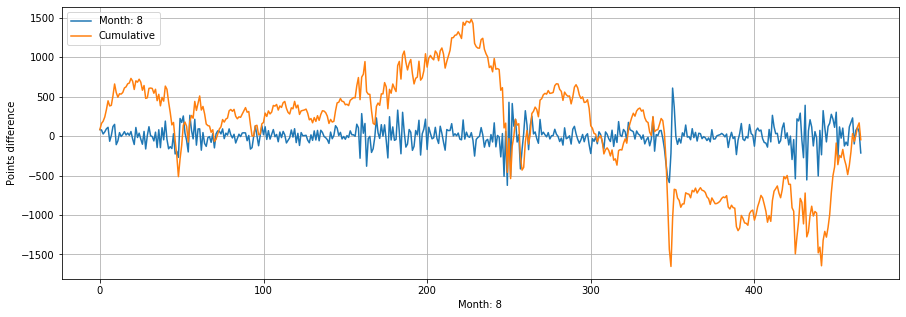

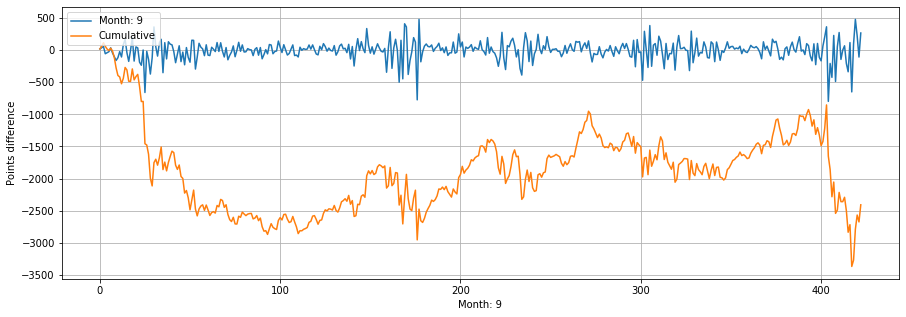

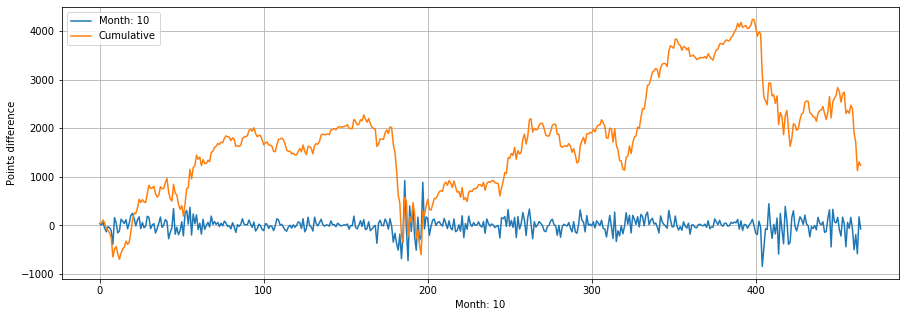

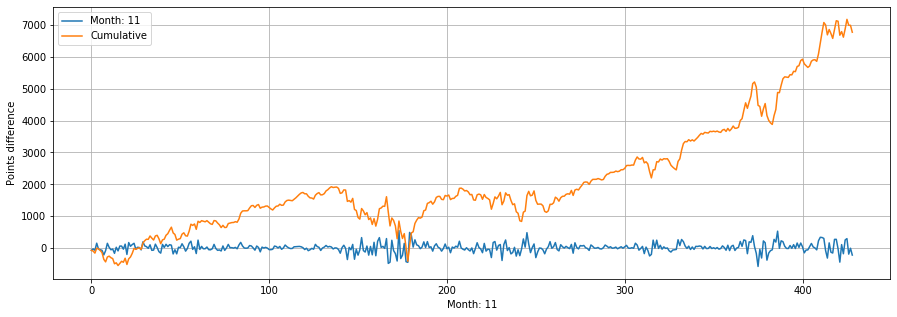

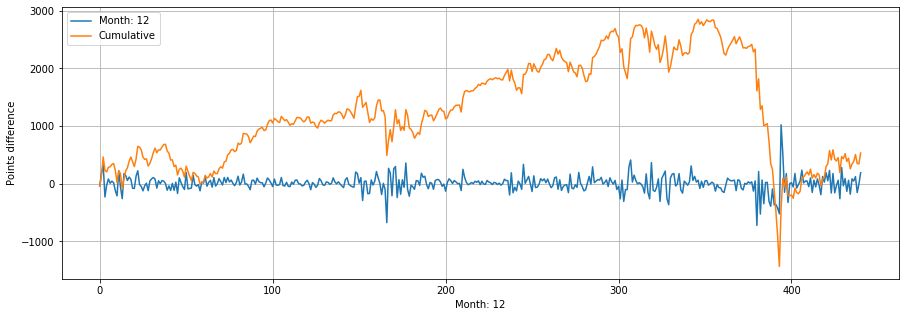

In [9]:
x_var = xmonth
x_label = "Month: "
y_label = "Points difference"
legend1 = "Month: "
legend2 = "Cumulative"

for period in range(NUM_OF_VARS):
    if period > 0:
        plot_periods(x_var, period, x_label, y_label, legend1,legend2)

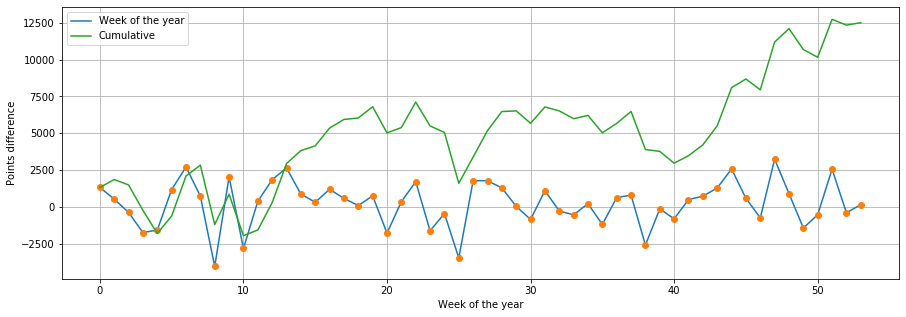

In [10]:
#===================================================
# Week of the year
NUM_OF_VARS = 53 
# var = "week"
#===================================================

x_label="Week of the year"
y_label="Points difference"
legend1="Week of the year"
legend2="Cumulative"

plot_variable(xweek, x_label, y_label, legend1,legend2)

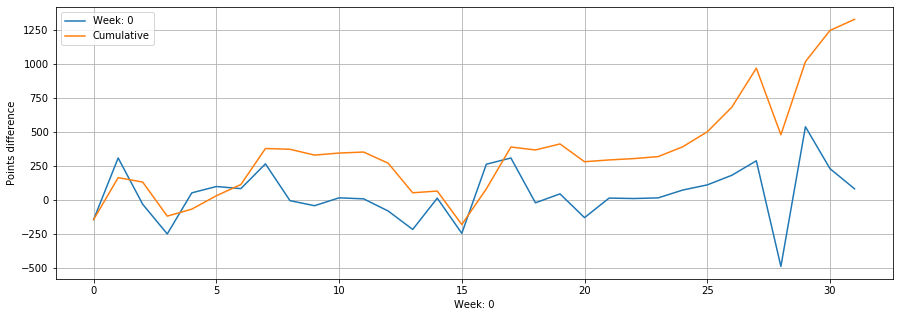

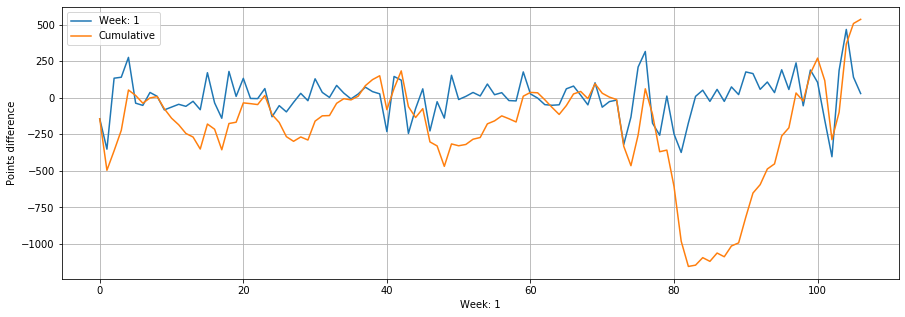

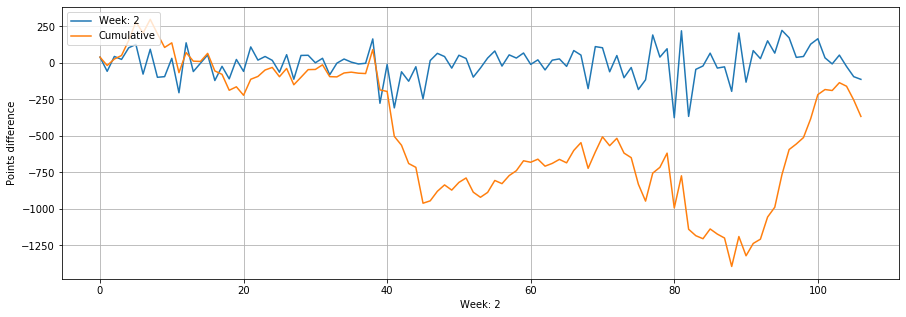

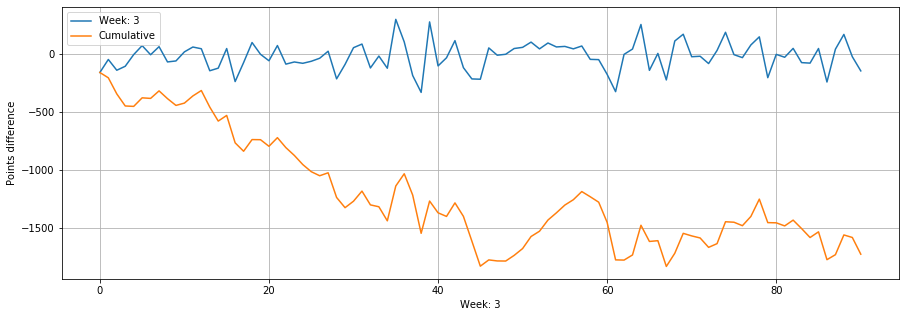

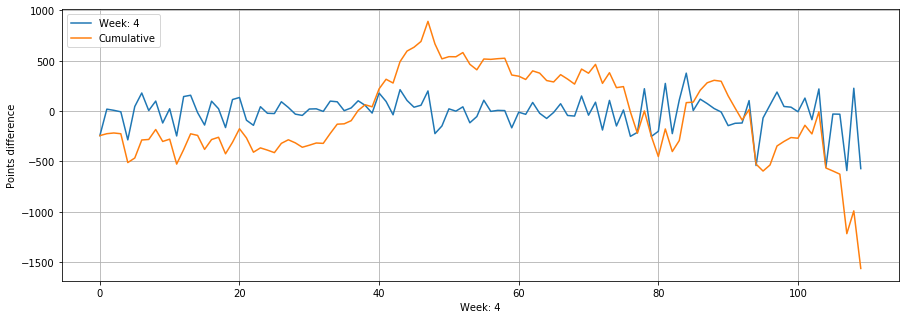

...

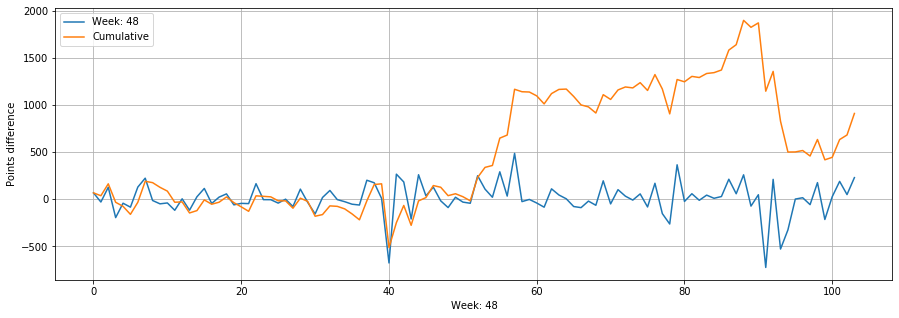

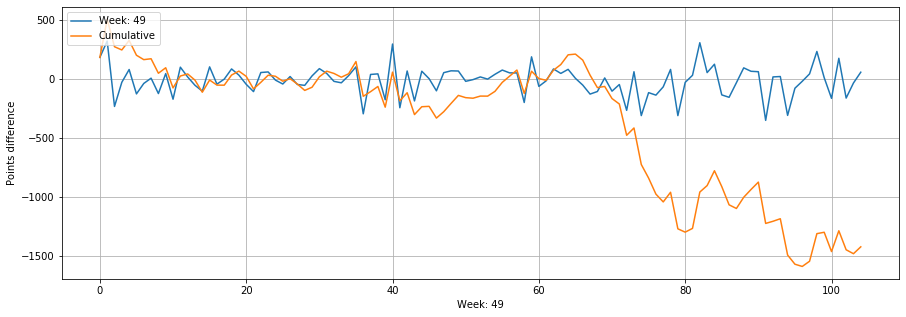

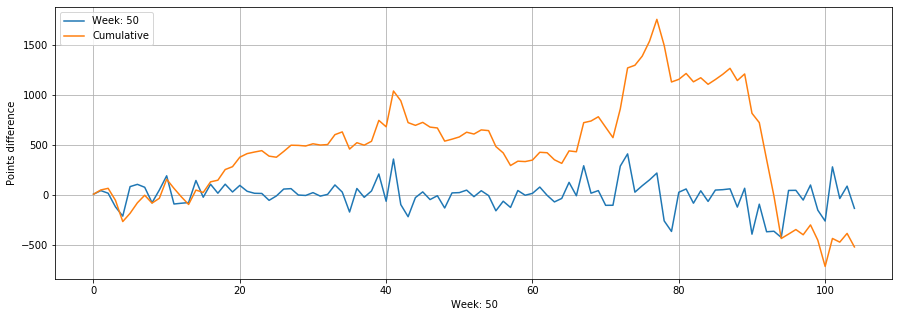

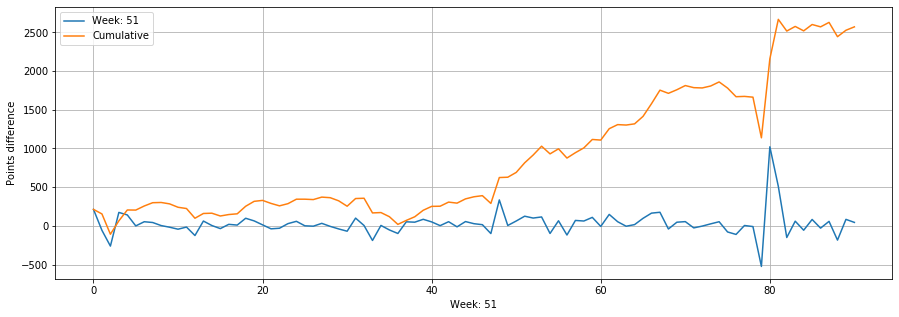

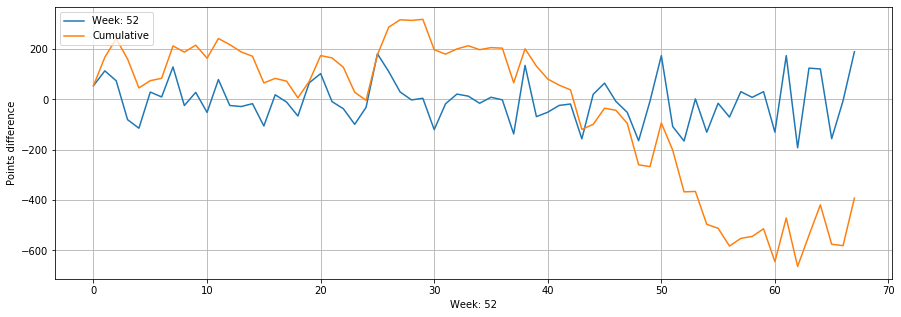

In [11]:
x_var = xweek
x_label = "Week: "
y_label = "Points difference"
legend1 = "Week: "
legend2 = "Cumulative"

for period in range(NUM_OF_VARS):
    plot_periods(x_var, period, x_label, y_label, legend1,legend2)    

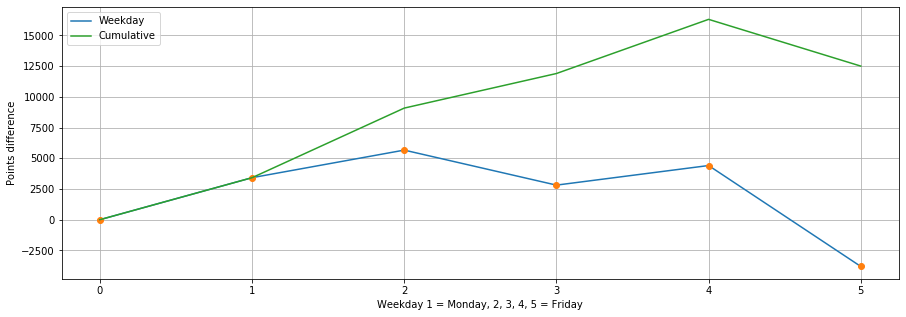

In [12]:
#===================================================
# Week day
NUM_OF_VARS = 6
# var = "weekday"
#===================================================

x_label="Weekday 1 = Monday, 2, 3, 4, 5 = Friday"
y_label="Points difference"
legend1="Weekday"
legend2="Cumulative"

plot_variable(xweekday, x_label, y_label, legend1,legend2)

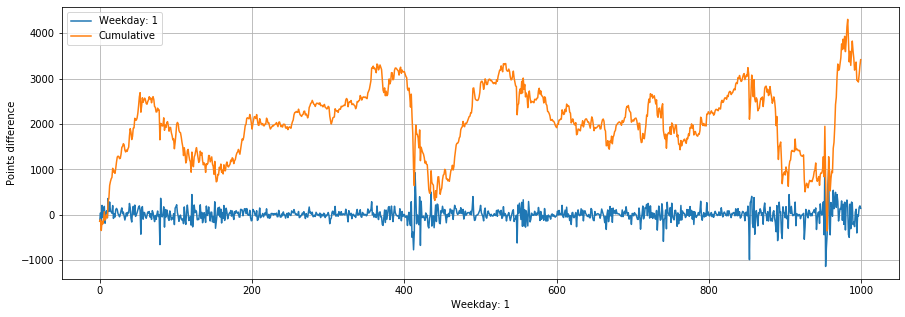

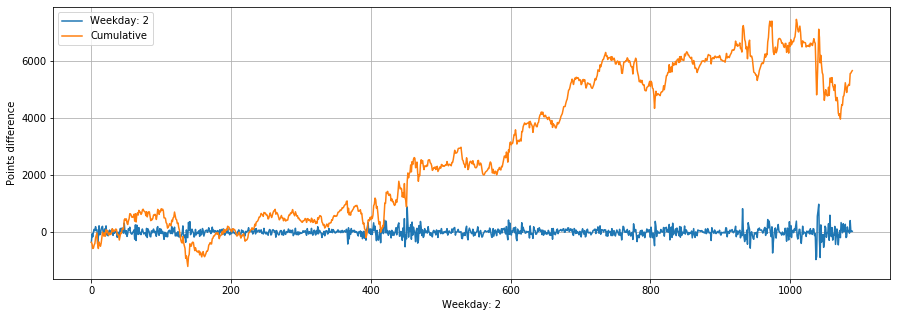

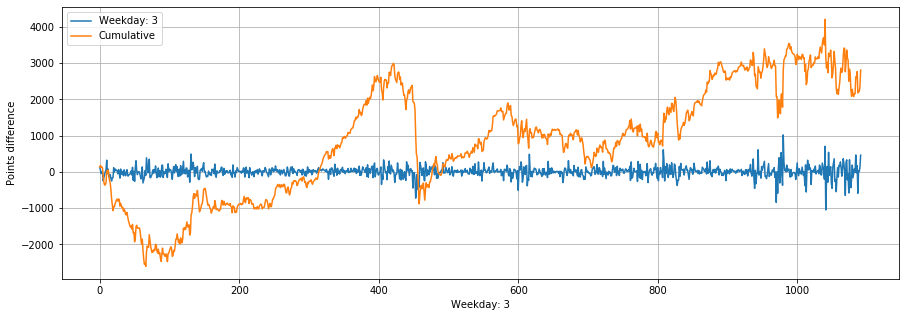

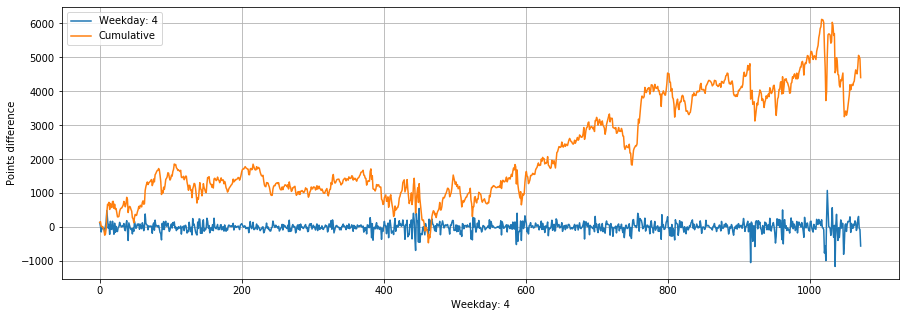

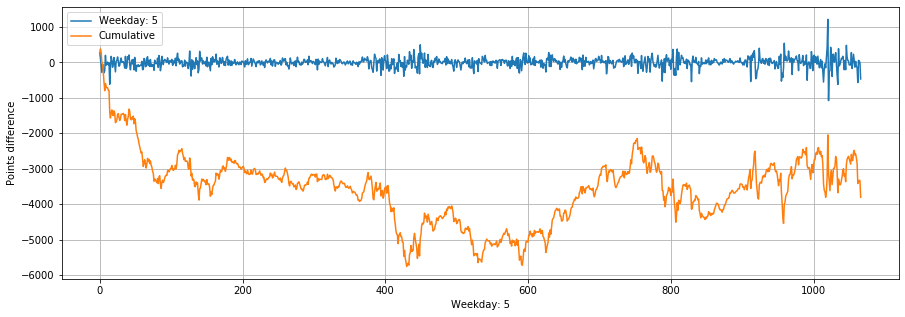

In [13]:
x_var = xweekday
x_label = "Weekday: "
y_label = "Points difference"
legend1 = "Weekday: "
legend2 = "Cumulative"

for period in range(NUM_OF_VARS):
    if period > 0:
        plot_periods(x_var, period, x_label, y_label, legend1,legend2)    

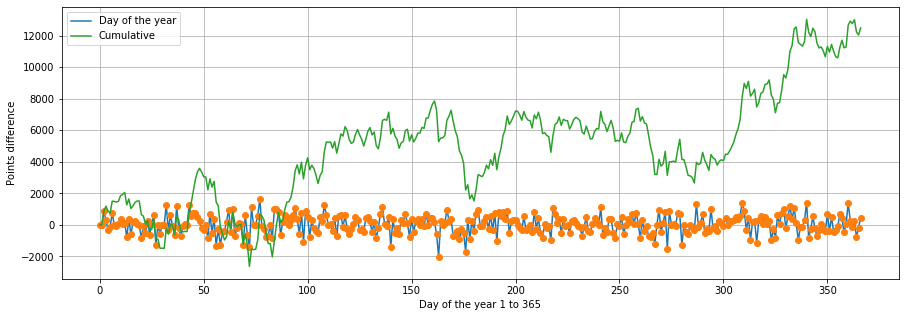

In [14]:
#===================================================
# Day of the year
NUM_OF_VARS = 367 #
# var = "day365"
#===================================================

x_label="Day of the year 1 to 365"
y_label="Points difference"
legend1="Day of the year"
legend2="Cumulative"

plot_variable(xday365, x_label, y_label, legend1,legend2)

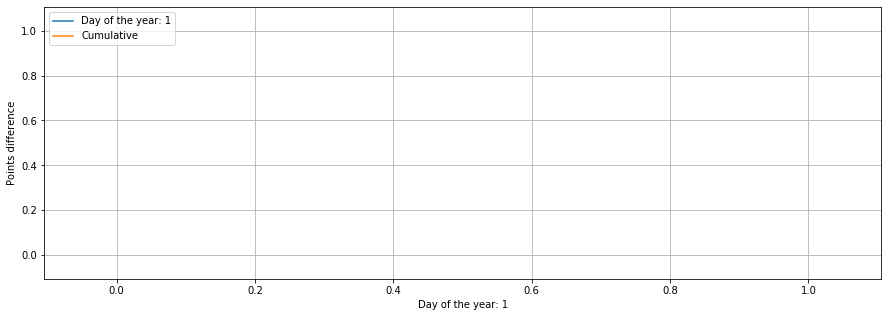

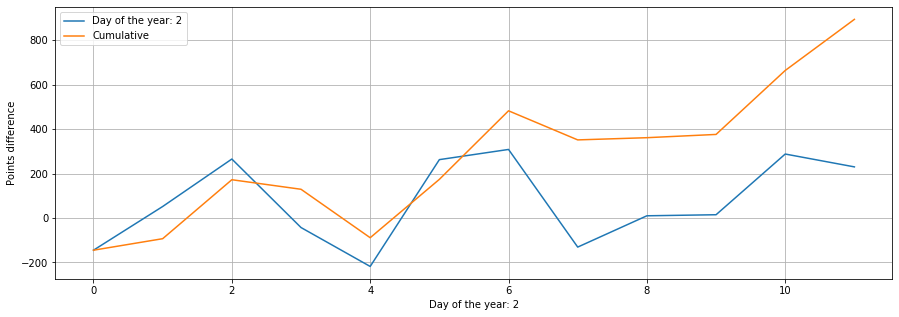

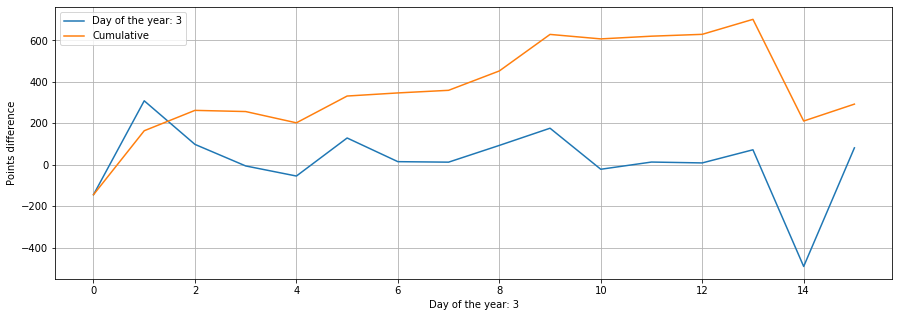

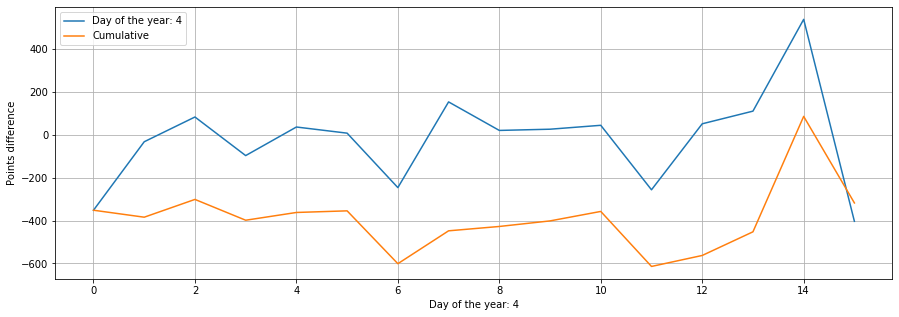

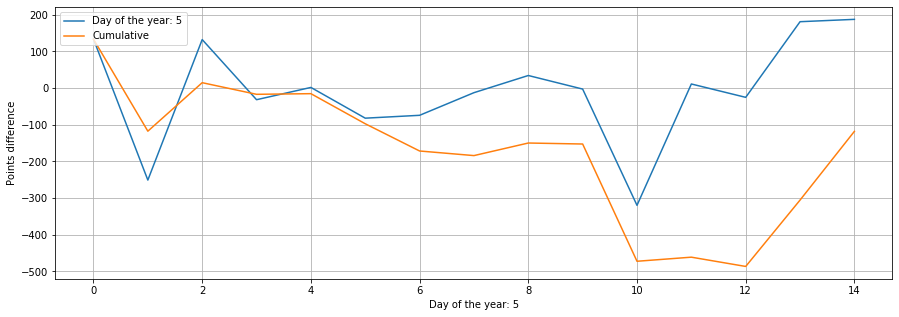

...

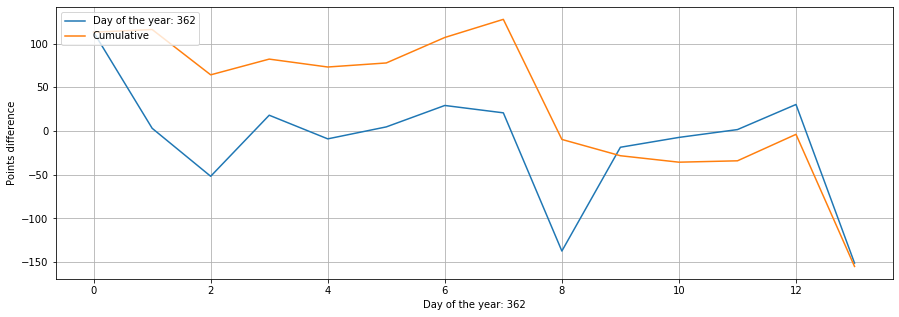

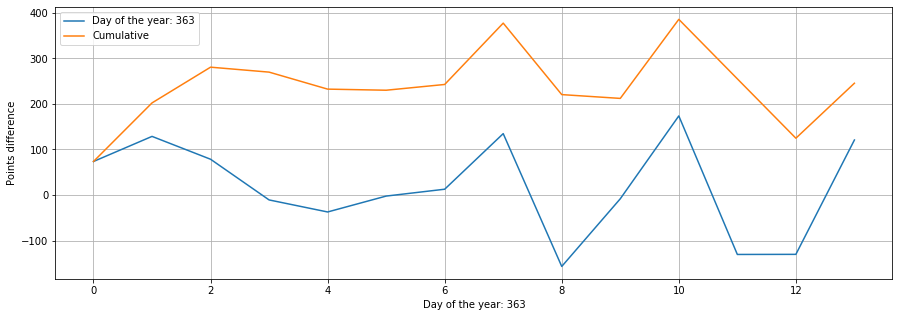

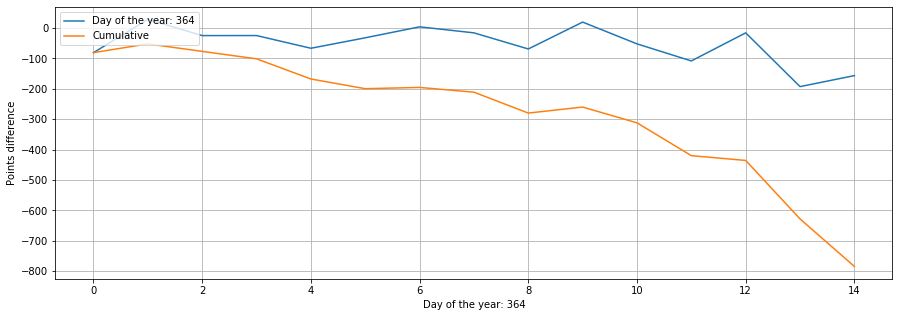

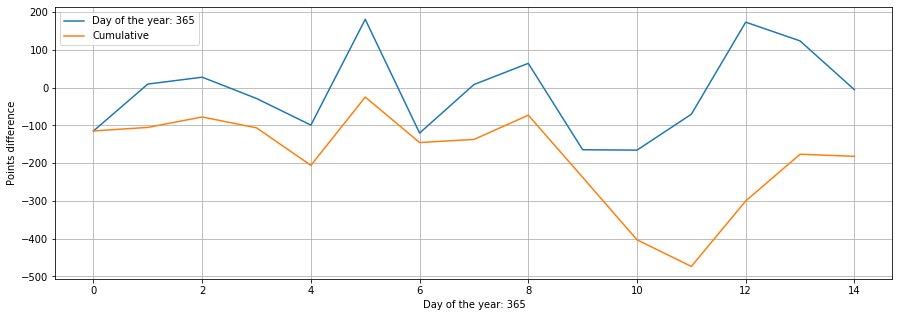

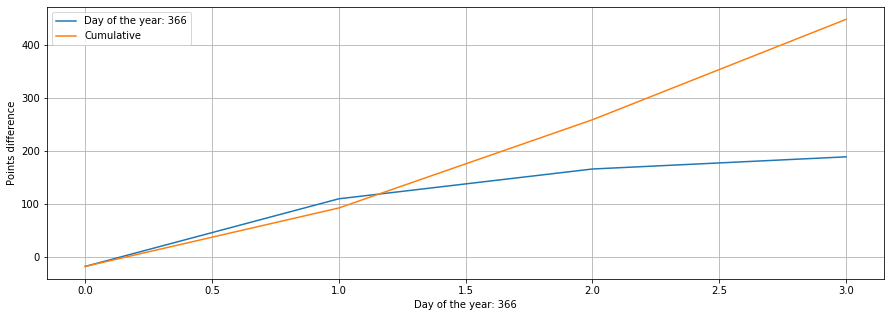

In [15]:
x_var = xday365
x_label = "Day of the year: "
y_label = "Points difference"
legend1 = "Day of the year: "
legend2 = "Cumulative"

for period in range(NUM_OF_VARS):
    if period > 0:
        plot_periods(x_var, period, x_label, y_label, legend1,legend2)    